In [1]:
import csv
import pandas as pd
import numpy as np

In [2]:
cardio = pd.read_csv('cardiovascular_diseases_dv3.csv', delimiter=';')

In [3]:
cols = cardio.columns
cardio.head()

,AGE,GENDER,HEIGHT,WEIGHT,AP_HIGH,AP_LOW,CHOLESTEROL,GLUCOSE,SMOKE,ALCOHOL,PHYSICAL_ACTIVITY,CARDIO_DISEASE
0,50,2,168,62,110,80,1,1,0,0,1,0
1,55,1,156,85,140,90,3,1,0,0,1,1
2,52,1,165,64,130,70,3,1,0,0,0,1
3,48,2,169,82,150,100,1,1,0,0,1,1
4,48,1,156,56,100,60,1,1,0,0,0,0


<AxesSubplot:>

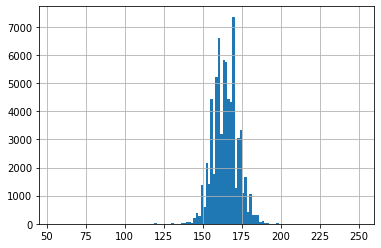

In [4]:
cardio['HEIGHT'].hist(bins=125)

<AxesSubplot:>

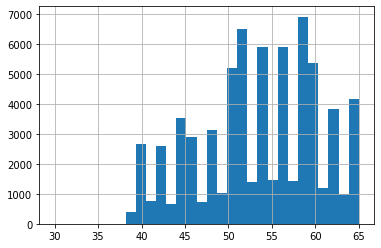

In [5]:
cardio['AGE'].hist(bins=30)

In [6]:
def categorizor_age(column):
    age = []
    for val in column:
        if val < np.percentile(column,25):
            age.append('young')
        elif val >= np.percentile(column,25) and val <= np.percentile(column,75):
            age.append('middleAge')
        else:
            age.append('elderly')
    return age

def gender(column):
    gender = []
    for val in column:
        if val == 1:
            gender.append('female')
        else:
            gender.append('male')
    return gender
    
def categorizor_height(column):
    height = []
    for val in column:
        if val < np.percentile(column,25):
            height.append('short')
        elif val >= np.percentile(column,25) and val <= np.percentile(column,75):
            height.append('medium')
        else:
            height.append('tall')
    return height

def categorizor_weight(weight, height):
    weights = weight.tolist()
    heights = height.tolist()
    print(len(weights))
    bmis = []
    for i in range(len(weights)):
        bmi = weights[i]/(0.01*heights[i])**2
        if bmi < 18.5:                           #bmi less than 18.5 is considered underweight
            bmis.append('underweight')
        elif bmi >= 18.5 and bmi <= 29.9:        #bmi between 18.5 and 30 is ideal
            bmis.append('ideal')
        elif bmi > 29.9:                         #bmi more than 30 is obese
            bmis.append('obese')
    return bmis

def categorizor_systolic(pressure):              # 120
    h_pressures = []
    for press in pressure:
        if press < 110:
            h_pressures.append('lowBP')
        elif press >= 110 and press <= 130:
            h_pressures.append('normal')
        elif press > 130:
            h_pressures.append('highBP')
    return h_pressures

def categorizor_diastolic(pressure):
    l_pressures = []
    for press in pressure:
        if press < 70:
            l_pressures.append('lowBP')
        elif press >= 70 and press <= 90 :
            l_pressures.append('medium')
        elif press > 90:
            l_pressures.append('highBP')
    return l_pressures

def cholesterol(column):
    chols = []
    for val in column:
        if val == 1:
            chols.append('normal')
        elif val == 2:
            chols.append('high')
        else:
            chols.append('veryHigh')
    return chols

def glucose(column):
    glu = []
    for val in column:
        if val == 1:
            glu.append('normal')
        elif val == 2:
            glu.append('high')
        else:
            glu.append('veryHigh')
    return glu

def smoke(column):
    smok = []
    for val in column:
        if val == 0:
            smok.append('no')
        elif val == 1:
            smok.append('yes')
    return smok

def alcohol(column):
    alco = []
    for val in column:
        if val == 0:
            alco.append('no')
        elif val == 1:
            alco.append('yes')
    return alco

def physical_activity(column):
    pa = []
    for val in column:
        if val == 0:
            pa.append('no')
        elif val == 1:
            pa.append('yes')
    return pa

def disease(column):
    target = []
    for val in column:
        if val == 0:
            target.append('no')
        elif val == 1:
            target.append('yes')
    return target

In [7]:
cardio['age'] = categorizor_age(cardio.AGE)
cardio['gender'] = gender(cardio.GENDER)
cardio['height'] = categorizor_height(cardio.HEIGHT)
cardio['bmi'] = categorizor_weight(cardio.WEIGHT, cardio.HEIGHT)
cardio['systolic'] = categorizor_systolic(cardio.AP_HIGH)
cardio['diastolic'] = categorizor_diastolic(cardio.AP_LOW)
cardio['cholesterol'] = cholesterol(cardio.CHOLESTEROL)
cardio['glucose'] = glucose(cardio.GLUCOSE)
cardio['smoke'] = smoke(cardio.SMOKE)
cardio['alcohol'] = alcohol(cardio.ALCOHOL)
cardio['physical_activity'] = physical_activity(cardio.PHYSICAL_ACTIVITY)
cardio['cardio_disease'] = disease(cardio.CARDIO_DISEASE)

68783


In [8]:
cardio = cardio.drop(['AGE', 'GENDER', 'HEIGHT', 'WEIGHT', 'AP_HIGH', 'AP_LOW', 'CHOLESTEROL', 'GLUCOSE', 'SMOKE', 'ALCOHOL', 'PHYSICAL_ACTIVITY', 'CARDIO_DISEASE'], axis=1)

In [9]:
cardio.head()

,age,gender,height,bmi,systolic,diastolic,cholesterol,glucose,smoke,alcohol,physical_activity,cardio_disease
0,middleAge,male,medium,ideal,normal,medium,normal,normal,no,no,yes,no
1,middleAge,female,short,obese,highBP,medium,veryHigh,normal,no,no,yes,yes
2,middleAge,female,medium,ideal,normal,medium,veryHigh,normal,no,no,no,yes
3,middleAge,male,medium,ideal,highBP,highBP,normal,normal,no,no,yes,yes
4,middleAge,female,short,ideal,lowBP,lowBP,normal,normal,no,no,no,no


In [11]:
cardio.to_csv('categorical_cardio.csv',index=False)

Since the dataset is very large with close to 70,000 rows and Aleph takes a large amount of time to process all the data, the learning examples have been restricted to 5000 examples.

In [12]:
file = open('categorical_cardio.csv')
csvreader = csv.reader(file)
header = []
header = next(csvreader)
#print(header)

# NotebookApp.iopub_data_rate_limit set to 2000000.0 to print more than default limit
for count,row in enumerate(csvreader):
        print("% person "+str(count))
        print("has_age(id_"+str(count)+","+str(row[0])+").")
        print("has_gender(id_"+str(count)+","+str(row[1])+").")
        print("has_height(id_"+str(count)+","+str(row[2])+").")
        print("has_bmi(id_"+str(count)+","+str(row[3])+").")
        print("has_systolic(id_"+str(count)+","+str(row[4])+").")
        print("has_diastolic(id_"+str(count)+","+str(row[5])+").")
        print("has_cholesterol(id_"+str(count)+","+str(row[6])+").")
        print("has_glucose(id_"+str(count)+","+str(row[7])+").")
        print("smoke(id_"+str(count)+","+str(row[8])+").")
        print("alcohol(id_"+str(count)+","+str(row[9])+").")
        print("exercise(id_"+str(count)+","+str(row[10])+").")
        print("\n\n")

% person 0
has_age(id_0,middleAge).
has_gender(id_0,male).
has_height(id_0,medium).
has_bmi(id_0,ideal).
has_systolic(id_0,normal).
has_diastolic(id_0,medium).
has_cholesterol(id_0,normal).
has_glucose(id_0,normal).
smoke(id_0,no).
alcohol(id_0,no).
exercise(id_0,yes).



% person 1
has_age(id_1,middleAge).
has_gender(id_1,female).
has_height(id_1,short).
has_bmi(id_1,obese).
has_systolic(id_1,highBP).
has_diastolic(id_1,medium).
has_cholesterol(id_1,veryHigh).
has_glucose(id_1,normal).
smoke(id_1,no).
alcohol(id_1,no).
exercise(id_1,yes).



% person 2
has_age(id_2,middleAge).
has_gender(id_2,female).
has_height(id_2,medium).
has_bmi(id_2,ideal).
has_systolic(id_2,normal).
has_diastolic(id_2,medium).
has_cholesterol(id_2,veryHigh).
has_glucose(id_2,normal).
smoke(id_2,no).
alcohol(id_2,no).
exercise(id_2,no).



% person 3
has_age(id_3,middleAge).
has_gender(id_3,male).
has_height(id_3,medium).
has_bmi(id_3,ideal).
has_systolic(id_3,highBP).
has_diastolic(id_3,highBP).
has_cholesterol

<b>The printed Aleph format values have been copied onto the cardio.pl file</b>

In [23]:
f1 = open("pos_examples.f", "x")
f2 = open("neg_examples.n", "x")
count = 0
for i in range(5000):                               # first 5000 examples
    if cardio.cardio_disease.values[i] == 'yes':
        f1.write('has_disease(id_'+str(count)+').\n')
    elif cardio.cardio_disease.values[i] == 'no':
        f2.write('has_disease(id_'+str(count)+').\n')
    count+=1

In [24]:
from PyILP.PyILP import *
model=aleph_cross_validation(file="cardio.pl", CV=3, positive_example="pos_examples.f", negative_example="neg_examples.n", settings=[])

[error] [set(verbosity,0)]
[select example] [1]
[sat] [1]
[has_disease(id_1554)]

[bottom clause]
[literals] [11]
[saturation time] [0.01225000000010823]
[reduce]
[best label so far] [[1,0,2,1]/0]
[-------------------------------------]
[found clause]
has_disease(A) :-
   has_systolic(A,highBP).
[pos cover = 676 neg cover = 140] [pos-neg] [536]
[clause label] [[676,140,2,536]]
[clauses constructed] [6]
[-------------------------------------]
[-------------------------------------]
[good clause]
has_disease(A) :-
   has_systolic(A,highBP), has_glucose(A,normal).
[pos cover = 540 neg cover = 100] [pos-neg] [440]
[clause label] [[540,100,3,440]]
[clauses constructed] [12]
[-------------------------------------]
[-------------------------------------]
[good clause]
has_disease(A) :-
   has_systolic(A,highBP), smoke(A,no).
[pos cover = 608 neg cover = 127] [pos-neg] [481]
[clause label] [[608,127,3,481]]
[clauses constructed] [13]
[-------------------------------------]
[-------------------